In [131]:
import numpy as np
import pandas as pd
import matplotlib as mat
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
from sklearn.feature_selection import RFE,SelectFromModel,SelectKBest,chi2,VarianceThreshold
from sklearn import svm
from sklearn.utils import shuffle
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.tree import DecisionTreeClassifier
import xgboost as xg 
from xgboost import plot_importance
import lightgbm as lgb
import seaborn as sns
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from ngboost import NGBRegressor
from ngboost.learners import default_tree_learner
from ngboost.distns import Normal
from ngboost.scores import MLE
import plotly.express as px
import datetime as dt
import math
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout,LSTM,GRU, Bidirectional
from sklearn.metrics import mean_absolute_error,mean_squared_error, mean_absolute_error, explained_variance_score, r2_score,mean_absolute_percentage_error
import warnings
warnings.filterwarnings('ignore')

In [2]:
germany=pd.read_csv('German_Market.csv')
germany.head()

,Date,Start,End,Germany/Luxembourg [€/MWh],Total_(grid load),Residual_load,Hydro_pumped_storage,F_Total_(grid load),F_Residual_load,A_Biomass,...,Wind_offshore,Wind_onshore,Photovoltaics,Other,O_Photovoltaics_and_wind,O_Wind_offshore,O_Wind_onshore,O_Photovoltaics,Ex_Austria [MWh],Im_Austria [MWh]
0,1-Jun-23,12:00 AM,1:00 AM,84.15,43451.50,26835.25,726.25,43935.00,27763.00,4127.0,...,3900.25,12271.75,0.0,21999.00,16837.75,4076.75,12761.00,0.0,25.00,9.50
1,1-Jun-23,1:00 AM,2:00 AM,74.30,41775.25,25943.75,876.00,41920.00,26357.00,4094.0,...,3635.25,11927.75,0.0,21147.00,15977.25,3862.25,12115.00,0.0,1.75,48.50
2,1-Jun-23,2:00 AM,3:00 AM,70.10,40959.50,25908.25,2059.25,41039.50,25608.25,4060.0,...,3644.75,11786.50,0.0,20161.75,15351.25,3735.50,11615.75,0.0,9.75,28.75
3,1-Jun-23,3:00 AM,4:00 AM,66.72,41313.00,26450.00,3341.50,41016.00,25950.00,4049.5,...,3678.25,11387.75,0.0,19787.00,14640.50,3563.75,11076.75,0.0,8.25,32.75
4,1-Jun-23,4:00 AM,5:00 AM,67.70,42379.25,27568.00,2430.50,42186.25,27511.75,4073.5,...,3715.50,10959.00,0.0,20554.50,14282.75,3515.00,10767.75,0.0,4.00,48.25


In [4]:
germany['Date']=germany['Date'].astype('datetime64[ns]')
germany

,Date,Start,End,Germany/Luxembourg [€/MWh],Total_(grid load),Residual_load,Hydro_pumped_storage,F_Total_(grid load),F_Residual_load,A_Biomass,...,Wind_offshore,Wind_onshore,Photovoltaics,Other,O_Photovoltaics_and_wind,O_Wind_offshore,O_Wind_onshore,O_Photovoltaics,Ex_Austria [MWh],Im_Austria [MWh]
0,2023-06-01,12:00 AM,1:00 AM,84.15,43451.50,26835.25,726.25,43935.00,27763.00,4127.00,...,3900.25,12271.75,0.00,21999.00,16837.75,4076.75,12761.00,0.00,25.00,9.50
1,2023-06-01,1:00 AM,2:00 AM,74.30,41775.25,25943.75,876.00,41920.00,26357.00,4094.00,...,3635.25,11927.75,0.00,21147.00,15977.25,3862.25,12115.00,0.00,1.75,48.50
2,2023-06-01,2:00 AM,3:00 AM,70.10,40959.50,25908.25,2059.25,41039.50,25608.25,4060.00,...,3644.75,11786.50,0.00,20161.75,15351.25,3735.50,11615.75,0.00,9.75,28.75
3,2023-06-01,3:00 AM,4:00 AM,66.72,41313.00,26450.00,3341.50,41016.00,25950.00,4049.50,...,3678.25,11387.75,0.00,19787.00,14640.50,3563.75,11076.75,0.00,8.25,32.75
4,2023-06-01,4:00 AM,5:00 AM,67.70,42379.25,27568.00,2430.50,42186.25,27511.75,4073.50,...,3715.50,10959.00,0.00,20554.50,14282.75,3515.00,10767.75,0.00,4.00,48.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2923,2023-09-30,7:00 PM,8:00 PM,163.90,49298.50,44271.50,13.25,46420.50,40392.00,4440.75,...,1716.75,4293.50,18.25,28843.50,5901.25,1777.75,4107.25,16.25,0.75,157.75
2924,2023-09-30,8:00 PM,9:00 PM,134.10,47053.75,41354.50,35.50,44447.25,38902.75,4497.25,...,1589.50,3955.00,0.00,27268.50,5603.75,1691.75,3912.00,0.00,1.50,177.50
2925,2023-09-30,9:00 PM,10:00 PM,112.40,44367.75,38573.50,291.25,41803.25,36369.75,4549.50,...,1559.25,3874.25,0.00,24456.50,5556.50,1666.50,3890.00,0.00,0.00,242.25
2926,2023-09-30,10:00 PM,11:00 PM,107.40,41829.00,36367.00,293.25,39630.75,34178.00,4598.50,...,1575.50,3877.25,0.00,22779.25,5584.00,1689.25,3894.75,0.00,0.00,192.50


In [5]:
germany['Date']=pd.to_datetime(germany['Date'].apply(str)+' '+germany['Start'])
germany=germany.drop(['Start'], axis=1)
germany.head()

,Date,End,Germany/Luxembourg [€/MWh],Total_(grid load),Residual_load,Hydro_pumped_storage,F_Total_(grid load),F_Residual_load,A_Biomass,A_Hydropower,...,Wind_offshore,Wind_onshore,Photovoltaics,Other,O_Photovoltaics_and_wind,O_Wind_offshore,O_Wind_onshore,O_Photovoltaics,Ex_Austria [MWh],Im_Austria [MWh]
0,2023-06-01 00:00:00,1:00 AM,84.15,43451.50,26835.25,726.25,43935.00,27763.00,4127.0,2126.50,...,3900.25,12271.75,0.0,21999.00,16837.75,4076.75,12761.00,0.0,25.00,9.50
1,2023-06-01 01:00:00,2:00 AM,74.30,41775.25,25943.75,876.00,41920.00,26357.00,4094.0,2134.75,...,3635.25,11927.75,0.0,21147.00,15977.25,3862.25,12115.00,0.0,1.75,48.50
2,2023-06-01 02:00:00,3:00 AM,70.10,40959.50,25908.25,2059.25,41039.50,25608.25,4060.0,2152.25,...,3644.75,11786.50,0.0,20161.75,15351.25,3735.50,11615.75,0.0,9.75,28.75
3,2023-06-01 03:00:00,4:00 AM,66.72,41313.00,26450.00,3341.50,41016.00,25950.00,4049.5,2152.25,...,3678.25,11387.75,0.0,19787.00,14640.50,3563.75,11076.75,0.0,8.25,32.75
4,2023-06-01 04:00:00,5:00 AM,67.70,42379.25,27568.00,2430.50,42186.25,27511.75,4073.5,2260.50,...,3715.50,10959.00,0.0,20554.50,14282.75,3515.00,10767.75,0.0,4.00,48.25


In [6]:
germany=germany.drop(['End'], axis=1)

In [7]:
germany= germany.set_index("Date")
germany.index.name= None

In [8]:
germany=germany.astype(float)

# Check missing data

In [9]:
germany.isna().sum()

Germany/Luxembourg [€/MWh]     0
Total_(grid load)              0
Residual_load                  0
Hydro_pumped_storage           0
F_Total_(grid load)            0
F_Residual_load                0
A_Biomass                      0
A_Hydropower                   0
A_Wind_offshore                0
A_Wind_onshore                 0
A_Photovoltaics                0
A_Other_renewable              0
A_Lignite                      0
A_Hard_coal                    0
A_Fossil_gas                   0
A_Hydro_pumped_storage         0
A_Other_conventional           0
Total [MWh]                    0
Photovoltaics_and_wind         0
Wind_offshore                  0
Wind_onshore                   0
Photovoltaics                  0
Other                          0
O_Photovoltaics_and_wind      24
O_Wind_offshore               24
O_Wind_onshore                24
O_Photovoltaics                0
Ex_Austria [MWh]               0
Im_Austria [MWh]               0
dtype: int64

In [10]:
germany.interpolate(method='linear', limit_direction='forward', inplace=True, axis=0)

In [11]:
def missing_value_table(dataframe):
    mis_value=dataframe.isna().sum()
    
    mis_value_percent= 100 * dataframe.isna().sum() / len(dataframe)
    
    mis_table_value=pd.concat([mis_value,mis_value_percent],axis=1)
    
    mis_table_value=mis_table_value.rename(columns = {0 : 'Missing Values', 1 : '% of Total Values'}) #change the name of table
    
    return mis_table_value

In [12]:
missing_value= missing_value_table(germany)
missing_value

,Missing Values,% of Total Values
Germany/Luxembourg [€/MWh],0,0.0
Total_(grid load),0,0.0
Residual_load,0,0.0
Hydro_pumped_storage,0,0.0
F_Total_(grid load),0,0.0
F_Residual_load,0,0.0
A_Biomass,0,0.0
A_Hydropower,0,0.0
A_Wind_offshore,0,0.0
A_Wind_onshore,0,0.0


In [15]:
germany.describe().round(2)

,Germany/Luxembourg [€/MWh],Total_(grid load),Residual_load,Hydro_pumped_storage,F_Total_(grid load),F_Residual_load,A_Biomass,A_Hydropower,A_Wind_offshore,A_Wind_onshore,...,Wind_offshore,Wind_onshore,Photovoltaics,Other,O_Photovoltaics_and_wind,O_Wind_offshore,O_Wind_onshore,O_Photovoltaics,Ex_Austria [MWh],Im_Austria [MWh]
count,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,...,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00
mean,91.76,49588.98,29340.86,1367.18,48683.53,28401.54,4171.95,1882.72,1880.65,8309.48,...,1782.26,8314.72,10185.01,24192.48,20252.17,1796.26,8325.97,10193.14,32.80,48.63
std,46.44,8171.59,11347.63,1514.34,8239.42,11439.17,165.76,192.19,1443.55,6902.66,...,1320.23,7051.76,12083.18,5855.34,13804.04,1384.20,7069.45,12090.29,48.88,53.75
min,-500.00,30909.00,-3309.00,0.25,30544.75,-14040.25,3632.00,1283.50,0.00,111.50,...,36.50,203.00,0.00,1075.25,576.50,7.50,168.75,0.00,0.00,0.00
25%,78.13,42674.31,22127.31,144.25,41809.25,21102.31,4053.00,1756.44,702.94,2762.25,...,639.44,2746.31,0.00,19772.44,8452.69,625.60,2652.56,0.00,2.25,9.25
50%,95.46,48846.88,30135.75,689.62,48253.25,29266.75,4183.12,1884.38,1493.88,6258.25,...,1378.00,6023.75,3284.38,23424.75,18060.62,1397.62,6137.25,3310.38,14.25,32.00
75%,112.79,57326.81,37713.06,2330.06,56308.12,36866.62,4296.06,2026.81,2827.75,12148.38,...,2849.56,12002.38,19740.88,27979.25,30303.19,2797.88,12069.56,19812.81,44.50,70.31
max,524.27,65519.75,56425.75,6382.75,64930.50,53920.00,4598.50,2398.75,6508.50,33134.50,...,5418.75,35295.25,40792.50,41778.00,64172.75,5825.75,35122.50,40874.50,595.00,485.75


In [13]:
label={
"Germany/Luxembourg [€/MWh]",
"Total_(grid load)",
"Residual_load",
"Hydro_pumped_storage",
"F_Total_(grid load)",
"F_Residual_load",
"A_Biomass",
"A_Hydropower",
"A_Wind_offshore",
"A_Wind_onshore",
"A_Photovoltaics",
"A_Other_renewable",
"A_Lignite",
"A_Hard_coal",
"A_Fossil_gas",
"A_Hydro_pumped_storage",
"A_Other_conventional",
"Total [MWh]",
"Photovoltaics_and_wind",
"Wind_offshore",
"Wind_onshore",
"Photovoltaics",
"Other",
"O_Photovoltaics_and_wind",
"O_Wind_offshore",
"O_Wind_onshore",
"O_Photovoltaics",
"Ex_Austria [MWh]",
"Im_Austria [MWh]"
}

# finding Correlation 

In [14]:
correlations = germany.corr(method='pearson') #spearman,pearson,kendall
print(correlations["Germany/Luxembourg [€/MWh]"].sort_values(ascending=False))

Germany/Luxembourg [€/MWh]    1.000000
F_Residual_load               0.855063
Residual_load                 0.837097
Other                         0.798316
A_Fossil_gas                  0.679811
A_Lignite                     0.649218
A_Hydro_pumped_storage        0.578465
A_Hard_coal                   0.541942
A_Biomass                     0.340597
A_Other_renewable             0.192615
Total_(grid load)             0.151692
F_Total_(grid load)           0.111228
A_Other_conventional          0.108983
A_Hydropower                  0.097095
Ex_Austria [MWh]             -0.028932
Im_Austria [MWh]             -0.039249
A_Wind_offshore              -0.182270
O_Wind_offshore              -0.288356
Wind_offshore                -0.296624
Total [MWh]                  -0.355691
A_Wind_onshore               -0.416263
O_Photovoltaics              -0.429460
A_Photovoltaics              -0.429710
Photovoltaics                -0.431866
O_Wind_onshore               -0.449071
Wind_onshore             

In [15]:
correlations2 = germany.corr(method='spearman') #spearman,pearson,kendall
print(correlations2["Germany/Luxembourg [€/MWh]"].sort_values(ascending=False))

Germany/Luxembourg [€/MWh]    1.000000
F_Residual_load               0.901312
Residual_load                 0.899485
Other                         0.857441
A_Fossil_gas                  0.771964
A_Lignite                     0.763833
A_Hydro_pumped_storage        0.660683
A_Hard_coal                   0.585137
A_Biomass                     0.353207
Total_(grid load)             0.128737
A_Other_conventional          0.108757
F_Total_(grid load)           0.087784
A_Other_renewable             0.087539
A_Hydropower                  0.025171
Ex_Austria [MWh]              0.001719
Im_Austria [MWh]             -0.015897
A_Wind_offshore              -0.194377
O_Wind_offshore              -0.277137
Wind_offshore                -0.287847
Total [MWh]                  -0.337331
O_Photovoltaics              -0.349200
Photovoltaics                -0.350136
A_Photovoltaics              -0.353942
Wind_onshore                 -0.358867
O_Wind_onshore               -0.362228
A_Wind_onshore           

In [19]:
fig = make_subplots(rows=1, cols=1,x_title='Date',
                    y_title='Value')
for d in germany:
    fig.add_trace((go.Scatter(x=germany.index, y=germany[d], name = d,connectgaps=False)), row=1, col=1)
        
# for d in fig4.data:
#     fig.add_trace((go.Scatter(x=Turkey['Date'], y=d['y'],  name = d['name'],connectgaps=False)), row=2, col=1)  

fig.update_layout(title=dict(text="External Vs Price"),height=1000, width=1000)
fig.show()

# Normalize

In [16]:
kl=germany

In [17]:
klminmax=(kl-kl.min())/(kl.max()-kl.min())

In [18]:
fig = make_subplots(rows=1, cols=1,x_title='Date',
                    y_title='Value')
for d in klminmax:
    fig.add_trace((go.Scatter(x=klminmax.index, y=klminmax[d], name = d,connectgaps=False)), row=1, col=1)
        
# for d in fig4.data:
#     fig.add_trace((go.Scatter(x=Turkey['Date'], y=d['y'],  name = d['name'],connectgaps=False)), row=2, col=1)  

fig.update_layout(title=dict(text="External Vs Price"),height=1000, width=1000)
fig.show()

# Split the data for train and test

In [16]:
germany.rename(columns={'Germany/Luxembourg [€/MWh]': 'Price'}, inplace=True)

In [56]:
train_test_data=germany[["Price",
"F_Residual_load",               
"Residual_load",                 
"Other",                         
"A_Fossil_gas",                  
"A_Lignite",                     
"A_Hydro_pumped_storage",        
"A_Hard_coal",                   
"O_Photovoltaics_and_wind",     
"Photovoltaics_and_wind",       
"Hydro_pumped_storage"]]

##### Split the dataset 3 months(from june to august) for training and 1 month(september) for test

In [85]:
start_date=dt.datetime(2023,9,1)
end_date=dt.datetime(2023,10,1)

In [86]:
train=train_test_data.loc[(train_test_data.index<start_date)]
train

,Price,F_Residual_load,Residual_load,Other,A_Fossil_gas,A_Lignite,A_Hydro_pumped_storage,A_Hard_coal,O_Photovoltaics_and_wind,Photovoltaics_and_wind,Hydro_pumped_storage
2023-06-01 00:00:00,84.15,27763.00,26835.25,21999.00,6013.75,4675.25,259.25,1034.25,16837.75,16172.00,726.25
2023-06-01 01:00:00,74.30,26357.00,25943.75,21147.00,5857.75,4408.75,190.75,1081.50,15977.25,15563.00,876.00
2023-06-01 02:00:00,70.10,25608.25,25908.25,20161.75,5907.25,4517.50,127.25,1073.50,15351.25,15431.25,2059.25
2023-06-01 03:00:00,66.72,25950.00,26450.00,19787.00,5726.00,4420.25,140.50,1064.50,14640.50,15066.00,3341.50
2023-06-01 04:00:00,67.70,27511.75,27568.00,20554.50,5844.75,4345.00,126.75,1065.25,14282.75,14674.50,2430.50
...,...,...,...,...,...,...,...,...,...,...,...
2023-08-31 19:00:00,148.55,42913.25,42348.25,35244.75,7526.25,12205.00,3108.00,4067.50,12264.50,12168.25,9.00
2023-08-31 20:00:00,139.15,42530.25,41814.75,34767.00,7513.25,12243.25,3497.00,4009.50,10957.50,10626.00,11.00
2023-08-31 21:00:00,125.50,38758.75,38865.00,33568.25,7408.25,11924.75,1243.75,3793.50,11223.75,11110.75,467.75
2023-08-31 22:00:00,106.03,34293.50,34340.00,30778.00,6965.75,11312.25,566.25,2845.75,11635.50,11752.00,739.25


In [87]:
test=train_test_data.loc[(train_test_data.index>=start_date ) & (train_test_data.index<end_date)]
test

,Price,F_Residual_load,Residual_load,Other,A_Fossil_gas,A_Lignite,A_Hydro_pumped_storage,A_Hard_coal,O_Photovoltaics_and_wind,Photovoltaics_and_wind,Hydro_pumped_storage
2023-09-01 00:00:00,98.90,29742.75,31082.25,24167.75,5198.25,9480.50,587.75,2463.50,12866.75,11430.25,628.00
2023-09-01 01:00:00,95.97,28378.75,29431.00,22725.75,5114.25,9005.75,462.50,2308.75,12061.00,11102.25,1602.00
2023-09-01 02:00:00,93.29,27830.00,29525.00,21316.00,4526.75,8672.75,83.00,1979.00,11694.00,10703.00,3127.75
2023-09-01 03:00:00,93.07,28323.50,30156.00,21271.00,4474.25,8367.50,7.75,1971.75,10934.00,10195.00,3842.25
2023-09-01 04:00:00,94.08,30131.50,31579.00,21892.00,4811.25,8831.00,19.50,2051.00,9992.25,9821.00,3215.75
...,...,...,...,...,...,...,...,...,...,...,...
2023-09-30 19:00:00,163.90,40392.00,44271.50,28843.50,4559.75,10077.75,5071.75,2385.50,5901.25,6028.50,13.25
2023-09-30 20:00:00,134.10,38902.75,41354.50,27268.50,4524.75,9708.75,4607.00,2263.25,5603.75,5544.50,35.50
2023-09-30 21:00:00,112.40,36369.75,38573.50,24456.50,4585.50,8886.25,1794.50,2058.00,5556.50,5433.50,291.25
2023-09-30 22:00:00,107.40,34178.00,36367.00,22779.25,4276.00,8443.25,1646.25,1949.50,5584.00,5452.75,293.25


In [88]:
train['Price']

2023-06-01 00:00:00     84.15
2023-06-01 01:00:00     74.30
2023-06-01 02:00:00     70.10
2023-06-01 03:00:00     66.72
2023-06-01 04:00:00     67.70
                        ...  
2023-08-31 19:00:00    148.55
2023-08-31 20:00:00    139.15
2023-08-31 21:00:00    125.50
2023-08-31 22:00:00    106.03
2023-08-31 23:00:00     96.89
Name: Price, Length: 2208, dtype: float64

In [89]:
train_data=train.drop(['Price'],axis=1)
train_label=train['Price']
test_data=test.drop(['Price'],axis=1)
test_label=test['Price']

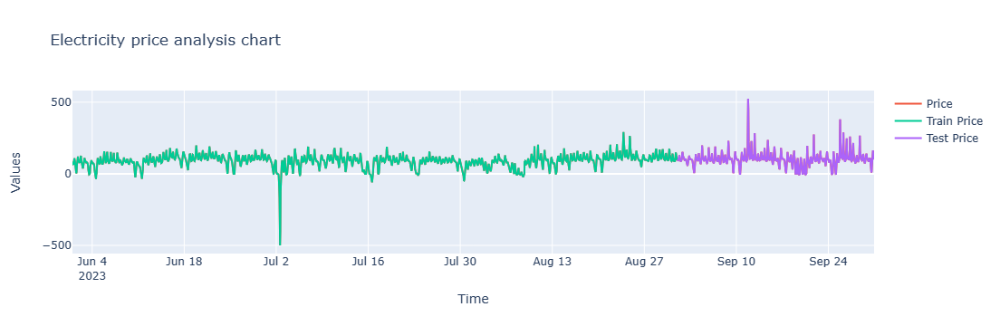

In [90]:
fig=px.line(title='Electricity price analysis chart').update_layout(
    xaxis_title="Time", yaxis_title="Values")
fig.add_scatter(x=germany.index, y= germany['Price'], name= "Price")
fig.add_scatter(x=train_label.index, y= train_label, name= "Train Price")
fig.add_scatter(x=test_label.index, y=test_label, name= "Test Price")

##### Scale the data

In [93]:
# Scale the data
scaler = MinMaxScaler()
scaled_train_data = scaler.fit_transform(train_data)
scaled_test_data = scaler.transform(test_data)

#### Model build

In [104]:
# Initialising the LSTM
regressor = Sequential()

# Adding the first LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 50,activation='relu', return_sequences = True,input_shape=(scaled_train_data.shape[1],1)))# input_shape = (X_train.shape[1], 1)
regressor.add(Dropout(0.2))

# #Adding a fourth LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 80,activation='relu', return_sequences = True))
regressor.add(Dropout(0.3))

#Adding a fourth LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 80,activation='relu', return_sequences = True))
regressor.add(Dropout(0.4))

#Adding a fourth LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 120,activation='relu'))
regressor.add(Dropout(0.5))


# Adding the output layer
regressor.add(Dense(units = 1))

# Compiling the RNN
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error',metrics="mean_absolute_error")
regressor.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 10, 50)            10400     
                                                                 
 dropout_4 (Dropout)         (None, 10, 50)            0         
                                                                 
 lstm_5 (LSTM)               (None, 10, 80)            41920     
                                                                 
 dropout_5 (Dropout)         (None, 10, 80)            0         
                                                                 
 lstm_6 (LSTM)               (None, 10, 80)            51520     
                                                                 
 dropout_6 (Dropout)         (None, 10, 80)            0         
                                                                 
 lstm_7 (LSTM)               (None, 120)              

In [105]:
# Fitting the RNN to the Training set
history = regressor.fit(np.expand_dims(scaled_train_data, axis=-1),
                              train_label, epochs = 50, batch_size = 64, verbose=1)#biki change the epochs to 200

Epoch 1/50


35/35 [==============================] - 6s 23ms/step - loss: 7557.0298 - mean_absolute_error: 75.6481
Epoch 2/50
35/35 [==============================] - 1s 23ms/step - loss: 1461.4180 - mean_absolute_error: 27.8533
Epoch 3/50
35/35 [==============================] - 1s 23ms/step - loss: 1128.8737 - mean_absolute_error: 23.4414
Epoch 4/50
35/35 [==============================] - 1s 24ms/step - loss: 1100.9286 - mean_absolute_error: 23.7176
Epoch 5/50
35/35 [==============================] - 1s 23ms/step - loss: 1014.0511 - mean_absolute_error: 22.2015
Epoch 6/50
35/35 [==============================] - 1s 22ms/step - loss: 948.8287 - mean_absolute_error: 21.6187
Epoch 7/50
35/35 [==============================] - 1s 25ms/step - loss: 891.4932 - mean_absolute_error: 20.7906
Epoch 8/50
35/35 [==============================] - 1s 23ms/step - loss: 842.8473 - mean_absolute_error: 19.8233
Epoch 9/50
35/35 [==============================] - 1s 23ms/step - loss: 786.0618 - mean_

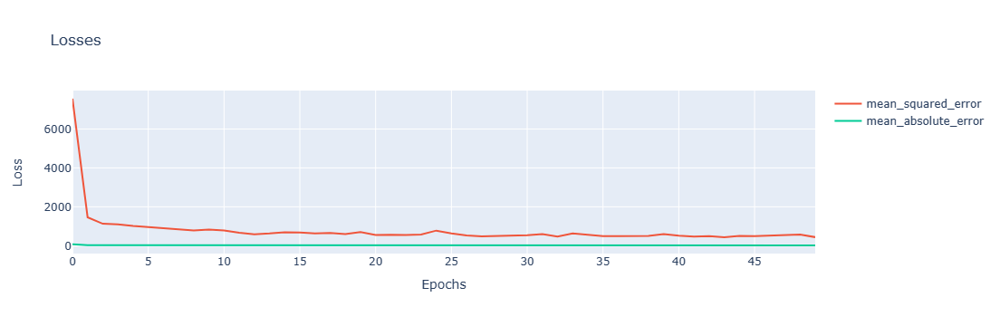

In [106]:
loss = history.history['loss']
val_loss = history.history['mean_absolute_error']

fig=px.line(title='Losses').update_layout(
    xaxis_title="Epochs", yaxis_title="Loss")
fig.add_scatter( y= loss, name= "mean_squared_error")
fig.add_scatter( y= val_loss, name= "mean_absolute_error")

# Evaluate the result

In [127]:
### Lets Do the prediction and check performance metrics
# train_predict=regressor.predict(np.expand_dims(scaled_train_data, axis=-1))
test_predict=regressor.predict(np.expand_dims(scaled_test_data, axis=-1))
test_predict.shape

23/23 [==============================] - 0s 8ms/step


(720, 1)

In [129]:
test_predict

array([[ 93.12933  ],
       [ 90.59311  ],
       [ 87.944534 ],
       [ 88.09717  ],
       [ 90.104546 ],
       [ 95.11178  ],
       [105.40812  ],
       [123.2969   ],
       [126.016495 ],
       [107.64933  ],
       [106.7908   ],
       [104.15441  ],
       [ 98.16982  ],
       [ 94.2328   ],
       [ 92.48017  ],
       [ 94.05119  ],
       [ 99.935555 ],
       [108.58779  ],
       [133.2044   ],
       [150.96243  ],
       [151.48016  ],
       [135.95497  ],
       [122.17258  ],
       [104.28757  ],
       [ 98.9429   ],
       [ 96.56781  ],
       [ 95.46877  ],
       [ 94.39225  ],
       [ 95.380585 ],
       [ 95.12678  ],
       [ 97.68539  ],
       [ 98.10356  ],
       [ 95.55142  ],
       [ 91.083595 ],
       [ 83.69442  ],
       [ 77.61987  ],
       [ 68.80318  ],
       [ 58.691788 ],
       [ 54.850506 ],
       [ 64.86214  ],
       [ 78.61017  ],
       [ 89.03774  ],
       [105.17476  ],
       [119.151794 ],
       [119.35078  ],
       [11

In [132]:
print("Test data RMSE: ", math.sqrt(mean_squared_error(test_label,test_predict)))
print("Test data MSE: ", mean_squared_error(test_label,test_predict))
print("Test data MAE: ", mean_absolute_error(test_label,test_predict))
print("Test data MAPE: ", mean_absolute_percentage_error(test_label,test_predict))

Test data RMSE:  24.92689592376911
Test data MSE:  621.350140394417
Test data MAE:  12.797868399831982
Test data MAPE:  131803001942497.17


In [134]:
print("Test data R2 score:", r2_score(test_label, test_predict))

Test data R2 score: 0.7342980256649865


In [136]:
test['Predictionlstm']=test_predict
test

,Price,F_Residual_load,Residual_load,Other,A_Fossil_gas,A_Lignite,A_Hydro_pumped_storage,A_Hard_coal,O_Photovoltaics_and_wind,Photovoltaics_and_wind,Hydro_pumped_storage,Predictionlstm
2023-09-01 00:00:00,98.90,29742.75,31082.25,24167.75,5198.25,9480.50,587.75,2463.50,12866.75,11430.25,628.00,93.129333
2023-09-01 01:00:00,95.97,28378.75,29431.00,22725.75,5114.25,9005.75,462.50,2308.75,12061.00,11102.25,1602.00,90.593109
2023-09-01 02:00:00,93.29,27830.00,29525.00,21316.00,4526.75,8672.75,83.00,1979.00,11694.00,10703.00,3127.75,87.944534
2023-09-01 03:00:00,93.07,28323.50,30156.00,21271.00,4474.25,8367.50,7.75,1971.75,10934.00,10195.00,3842.25,88.097168
2023-09-01 04:00:00,94.08,30131.50,31579.00,21892.00,4811.25,8831.00,19.50,2051.00,9992.25,9821.00,3215.75,90.104546
...,...,...,...,...,...,...,...,...,...,...,...,...
2023-09-30 19:00:00,163.90,40392.00,44271.50,28843.50,4559.75,10077.75,5071.75,2385.50,5901.25,6028.50,13.25,119.128197
2023-09-30 20:00:00,134.10,38902.75,41354.50,27268.50,4524.75,9708.75,4607.00,2263.25,5603.75,5544.50,35.50,114.283516
2023-09-30 21:00:00,112.40,36369.75,38573.50,24456.50,4585.50,8886.25,1794.50,2058.00,5556.50,5433.50,291.25,103.331291
2023-09-30 22:00:00,107.40,34178.00,36367.00,22779.25,4276.00,8443.25,1646.25,1949.50,5584.00,5452.75,293.25,99.142868


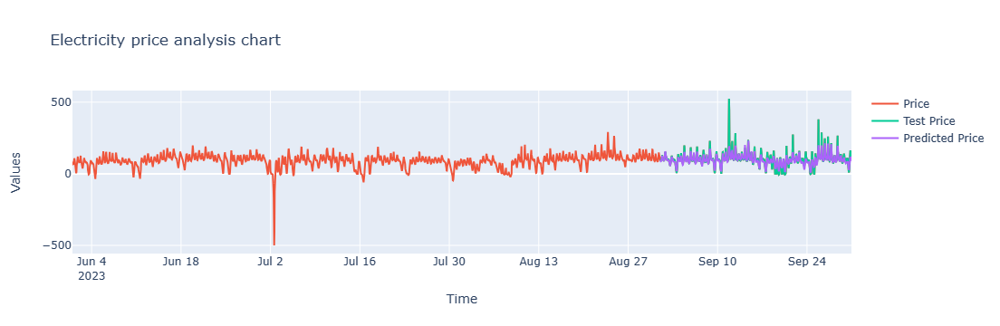

In [137]:
fig=px.line(title='Electricity price analysis chart').update_layout(
    xaxis_title="Time", yaxis_title="Values")
fig.add_scatter(x=germany.index, y= germany['Price'], name= "Price")
fig.add_scatter(x=test_label.index, y=test_label, name= "Test Price")
fig.add_scatter(x=test.index, y= test['Predictionlstm'], name= "Predicted Price")